In [1]:


import pandas as pd
import random
import time
import os
import imp
import cv2
import pickle
import numpy as np
from utils import OD_Assemble
import tensorflow as tf
from tqdm import tqdm
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from tensorflow.keras.preprocessing.image import img_to_array,load_img

# optional
# from google.colab.patches import cv2_imshow
from PIL import Image
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
%matplotlib inline


# Enable GPU dynamic memory allocation (do not use this for colab)
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)


In [2]:
# PATH_TO_SAVED_MODEL_1 = "../exported-models/faster_rcnn_resnet152_v1_800x1333/saved_model"
PATH_TO_SAVED_MODEL_1 = "../exported-models/00-old_models/efficientdet_d1/saved_model"

PATH_TO_LABELS = "../annotations/label_map.pbtxt"

print('Loading Model...')
start_time = time.time()
loaded_model_1 = tf.saved_model.load(PATH_TO_SAVED_MODEL_1)
print('Model loaded, pbtxt loading....')
# Loading the pbtxt
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

print('Done! Took {} seconds'.format(time.time() - start_time))

Loading Model...


Model loaded, pbtxt loading....
Done! Took 138.5375189781189 seconds


In [7]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')

### Saving the model predictions

In [4]:
def get_box(imagename):
    test_image_o = cv2.imread('../'+imagename)
    test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
    test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
    test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
    test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.
    
    # Predictions
    with tf.device('/cpu:0'):
          prediction = loaded_model_1(test_image_tensor)
    num_bboxes = int(prediction.pop('num_detections'))
    prediction = {key: value[0, :num_bboxes].numpy() for key, value in prediction.items()}
    prediction['num_detections'] = num_bboxes
        
    prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
    return prediction

In [8]:
master_list = []
for i in tqdm(range(df.shape[0])):
    prediction = get_box(df.iloc[i]['filename'])
    master_list.append(prediction)
    if (i+1)%3900==0:
        print('Saving...')
        # np.save('../annotations/ensemble_outputs/ssd_resnet152_v1_fpn_640x640_ckpt_'+str(i)+'.pkl', master_list)
        with open('../annotations/ensemble_outputs/efficientdet_d1/ckpts/efficientdet_d1_ckpt_'+str(i)+'.pkl', 'wb') as f:
            pickle.dump(master_list, f)
        f.close()

 25%|██▍       | 3899/15600 [37:50<1:53:01,  1.73it/s]

Saving...


 50%|████▉     | 7799/15600 [1:16:52<1:18:03,  1.67it/s]

Saving...


 75%|███████▍  | 11699/15600 [1:55:42<38:00,  1.71it/s]  

Saving...


100%|█████████▉| 15599/15600 [2:36:02<00:00,  1.61it/s]

Saving...


100%|██████████| 15600/15600 [2:36:04<00:00,  1.67it/s]


In [9]:
len(master_list)

15600

In [10]:
master_list[0].keys()
master_list[0]['detection_scores'].shape

(100,)

In [11]:
master_list[0]

{'detection_anchor_indices': array([76186., 76013., 74963., 76177., 76106., 76093., 76359., 76006.,
        76276., 76276., 76177., 76177., 76359., 76361., 76569., 74231.,
        76278., 76278., 76352., 76352., 74780., 74774., 76569., 75156.,
        75139., 75138., 76569., 75119., 76278., 76260., 75119., 76454.,
        75174., 73355., 76453., 75182., 76469., 74231., 70352., 76362.,
        75191., 76698., 76469., 75191., 76698., 75129., 74231., 76454.,
        75130., 76278., 75833., 74285., 75315., 74411., 74822., 76704.,
        76665., 76368., 70343., 74411., 76432., 75119., 76353., 73716.,
        70532., 76593., 76380., 73355., 75165., 75342., 76443., 76368.,
        74822., 70424., 75833., 67454., 75146., 74231., 74627., 76278.,
        76367., 76278., 74822., 76432., 76373., 74767., 75518., 75121.,
        75183., 76278., 73353., 74949., 76698., 76638., 76470., 76368.,
        74231., 73690., 74955., 74796.], dtype=float32),
 'detection_boxes': array([[0.25925538, 0.2588933 ,

In [12]:
import pickle

with open('../annotations/ensemble_outputs/efficientdet_d1/efficientdet_d1_BBOX.pkl', 'wb') as f:
    pickle.dump(master_list, f)

In [13]:
with open('../annotations/ensemble_outputs/efficientdet_d1/efficientdet_d1_BBOX.pkl', 'rb') as f:
    temp = pickle.load(f)

In [14]:
len(temp)

15600

In [15]:
temp[0]

{'detection_anchor_indices': array([76186., 76013., 74963., 76177., 76106., 76093., 76359., 76006.,
        76276., 76276., 76177., 76177., 76359., 76361., 76569., 74231.,
        76278., 76278., 76352., 76352., 74780., 74774., 76569., 75156.,
        75139., 75138., 76569., 75119., 76278., 76260., 75119., 76454.,
        75174., 73355., 76453., 75182., 76469., 74231., 70352., 76362.,
        75191., 76698., 76469., 75191., 76698., 75129., 74231., 76454.,
        75130., 76278., 75833., 74285., 75315., 74411., 74822., 76704.,
        76665., 76368., 70343., 74411., 76432., 75119., 76353., 73716.,
        70532., 76593., 76380., 73355., 75165., 75342., 76443., 76368.,
        74822., 70424., 75833., 67454., 75146., 74231., 74627., 76278.,
        76367., 76278., 74822., 76432., 76373., 74767., 75518., 75121.,
        75183., 76278., 73353., 74949., 76698., 76638., 76470., 76368.,
        74231., 73690., 74955., 74796.], dtype=float32),
 'detection_boxes': array([[0.25925538, 0.2588933 ,

### Checking the annotations

- loading label maps

In [27]:
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

MODEL_LIST = os.listdir('../annotations/ensemble_outputs/single_model_preds')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/single_model_preds/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
MODEL_LIST

['centernet_resnet101_v1_512x512_BBOX.pkl',
 'efficientdet_d1_BBOX.pkl',
 'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl',
 'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl',
 'faster_rcnn_resnet101_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_800x1333_BBOX.pkl',
 'faster_rcnn_resnet50_v1_640x640_BBOX.pkl',
 'ssd_resnet152_v1_fpn_640x640.pkl']

### for efficientdet

In [17]:
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

MODEL_LIST = os.listdir('../annotations/ensemble_outputs/efficientdet_d1/allbox')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/efficientdet_d1/allbox/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
MODEL_LIST

['efficientdet_d1_BBOX.pkl']

In [28]:
predictions_dict.keys()

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8])

In [20]:

def show_inference_s(location=0,model=0):
    d = df.iloc[location]
    prediction = predictions_dict[model][location]
    
    test_image_o = cv2.imread('../'+d['filename'])
    test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
    test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
    test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
    test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.
      
    # num_bboxes = int(prediction['num_detections'])
    # prediction = {key: value[0, :num_bboxes].numpy() for key, value in prediction.items()}
    # prediction['num_detections'] = num_bboxes
    
    prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
    image_with_detections = test_image_rgb.copy()
    
    viz_utils.visualize_boxes_and_labels_on_image_array(
        image_with_detections,
        prediction['detection_boxes'],
        prediction['detection_classes'],
        prediction['detection_scores'],
        category_index,
        instance_masks=prediction.get('detection_masks_reframed', None),
        use_normalized_coordinates=True,
        line_thickness=8)
    return image_with_detections
 
 
def show_inference(frame,location=0,model=0):
    
    prediction = predictions_dict[model][location]
    test_image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
    test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
    test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.
      
    # num_bboxes = int(prediction['num_detections'])
    # prediction = {key: value[0, :num_bboxes].numpy() for key, value in prediction.items()}
    # prediction['num_detections'] = num_bboxes
    
    prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
    image_with_detections = test_image_rgb.copy()
    
    viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            prediction['detection_boxes'],
            prediction['detection_classes'],
            prediction['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
    return image_with_detections

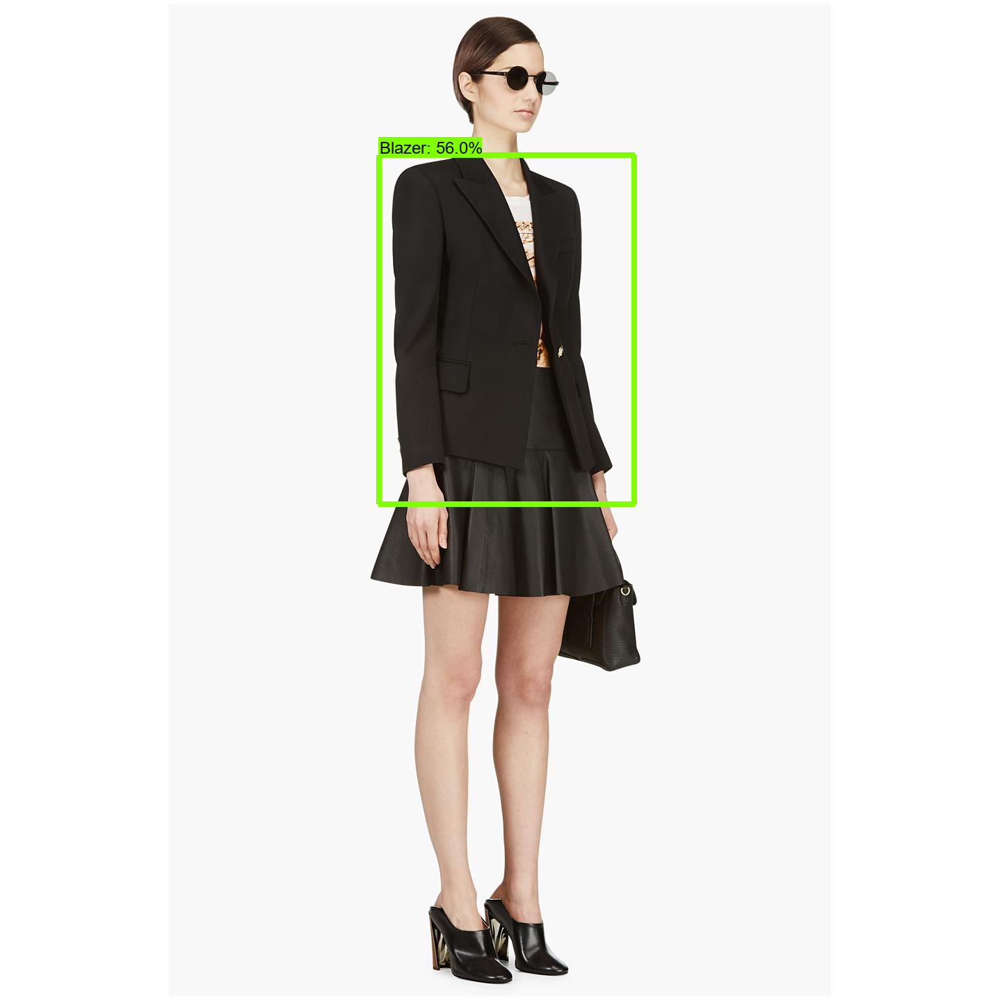

In [25]:
inference = show_inference_s(4,0)
Image.fromarray(inference)

In [24]:
imp.reload(OD_Assemble)
nmodels = [0,1,2,3]
combine = OD_Assemble.NCombiner(indexes=nmodels,con_thresh=0.6,iou_thresh=0.55)

In [32]:
cols = ['Ensemble','Groundtruth']
cols.extend([MODEL_LIST[mdl] for mdl in nmodels])
print(cols)

['Ensemble', 'Groundtruth', 'centernet_resnet101_v1_512x512_BBOX.pkl', 'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl', 'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl', 'faster_rcnn_resnet101_v1_640x640_BBOX.pkl']


<Figure size 4608x3456 with 0 Axes>

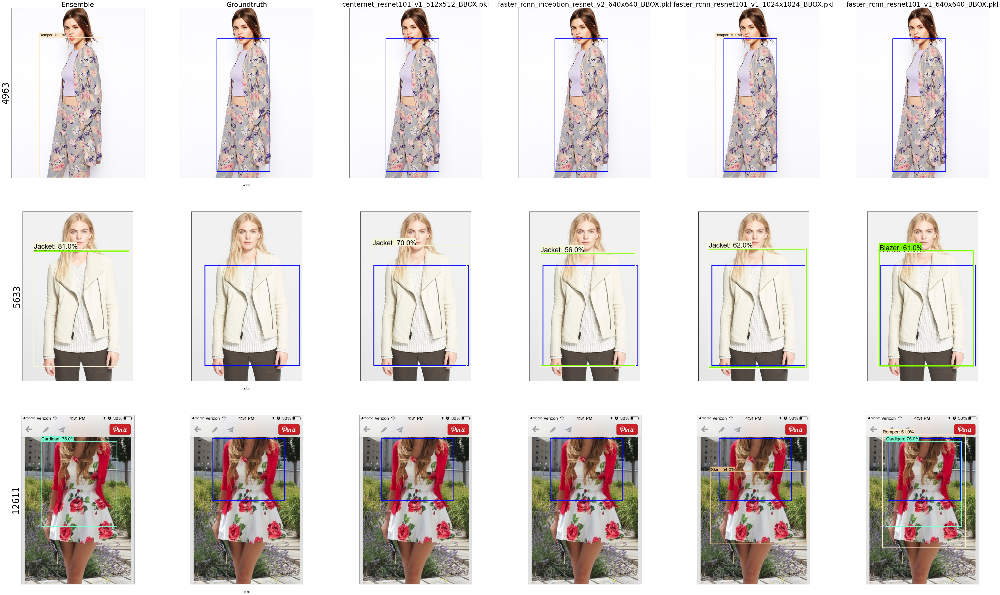

In [34]:
samples = 3
sams = random.sample(range(15600),samples)


plt.figure(figsize=(16*len(nmodels),16*samples))

cols = ['Ensemble','Groundtruth']
cols.extend([MODEL_LIST[mdl] for mdl in nmodels])
rows = sams

fig, axes = plt.subplots(nrows=samples, ncols=len(nmodels)+2, figsize=(20*len(nmodels),16*samples))

for ax, col in zip(axes[0], cols):
    ax.set_title(col,fontdict={'fontsize': 30})

for ax, row in zip(axes[:,0], rows):
    # print(row)
    ax.set_ylabel(row, fontsize=40)

for i in range(len(sams)):
    loc = sams[i]
    d = df.iloc[loc]
    test_image_o = cv2.imread('../'+d['filename'])
    
    axs = axes[i][0]
    image_with_detections = combine.Wfb(location=loc,operator=2,visualize=1)
    axs.imshow(image_with_detections)
    axs.set_yticks([])
    axs.set_xticks([])
    
    x1,y1,x2,y2 = d[['xmin','ymin','xmax','ymax']].values
    grndimg = cv2.rectangle(test_image_o,(x1,y1),(x2,y2),(255, 0, 0), 2)
    
    axs = axes[i][1]
    axs.imshow(cv2.cvtColor(grndimg, cv2.COLOR_BGR2RGB))
    axs.text(0.5,-0.05, d['class'], size=12, ha="center",transform=axs.transAxes)
    axs.set_yticks([])
    axs.set_xticks([])
    
    for j in range(len(nmodels)):
        axs = axes[i][j+2]
        modl = nmodels[j]
        inference = show_inference(test_image_o,loc,modl)
        axs.imshow(inference)
        axs.set_yticks([])
        axs.set_xticks([])
    
plt.show()

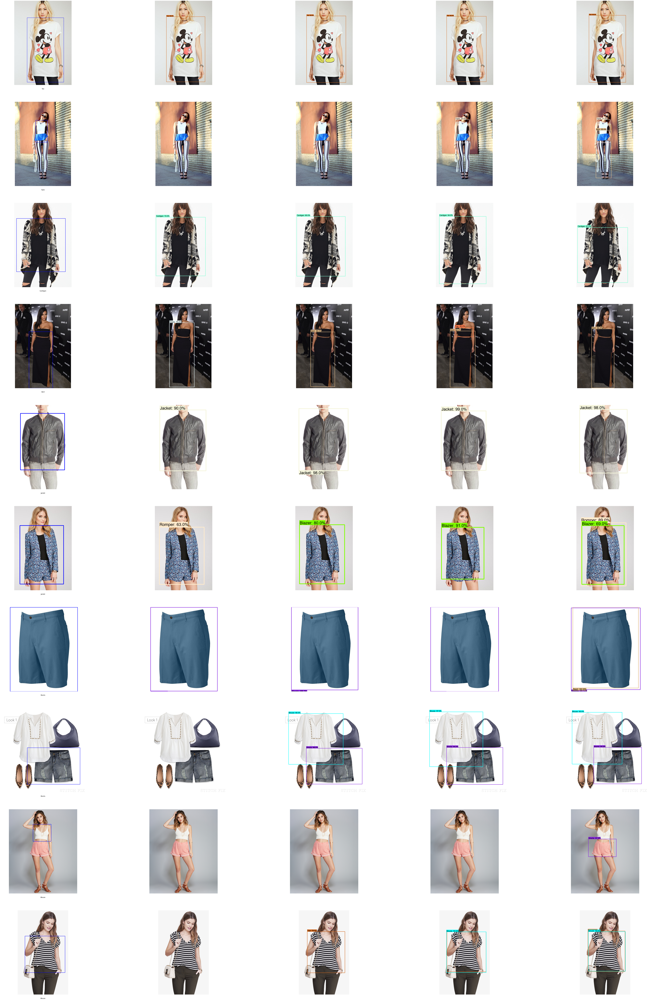

In [9]:
samples = 10
sams = random.sample(range(15600),samples)
nmodels = [0,1,2,3]

plt.figure(figsize=(20*len(nmodels),16*samples))

cols = [MODEL_LIST[mdl] for mdl in nmodels]
rows = sams

fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(12, 8))

for ax, col in zip(axes[0], cols):
    ax.set_title(col)

for ax, row in zip(axes[:,0], rows):
    ax.set_ylabel(row, rotation=0, size='large')

for i,loc in enumerate():
    d = df.iloc[loc]
    test_image_o = cv2.imread('../'+d['filename'])
    inference1 = show_inference(test_image_o,loc,1)
    inference2 = show_inference(test_image_o,loc,2)
    inference3 = show_inference(test_image_o,loc,4)
    inference4 = show_inference(test_image_o,loc,5)
    
    # image_with_detections = combine.NWfb('../'+d['filename'],2)
    
    x1,y1,x2,y2 = d[['xmin','ymin','xmax','ymax']].values
    grndimg = cv2.rectangle(test_image_o,(x1,y1),(x2,y2),(255, 0, 0), 2)
        
    p = plt.subplot(samples,5,i*5+1)
    plt.axis('off')
    plt.imshow(cv2.cvtColor(grndimg, cv2.COLOR_BGR2RGB))
    plt.text(0.5,-0.05, d['class'], size=12, ha="center",transform=p.transAxes)
    
    plt.subplot(samples,5,i*5+2)
    plt.axis('off')
    plt.imshow(inference1)
    
    plt.subplot(samples,5,i*5+3)
    plt.axis('off')
    plt.imshow(inference2)
    
    plt.subplot(samples,5,i*5+4)
    plt.axis('off')
    plt.imshow(inference3)
    
    plt.subplot(samples,5,i*5+5)
    plt.axis('off')
    plt.imshow(inference4)
    
    
#     plt.subplot(samples,5,i*5+5)
#     plt.axis('off')
#     plt.imshow(image_with_detections)
# plt.savefig('outputs/output_'+str(int(time.time()))+'.png', bbox_inches='tight')
plt.show()

### Adjusting the WBF function

- loading the label maps and predictions

In [88]:
# df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
# PATH_TO_LABELS = "../annotations/label_map.pbtxt"
# category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

# MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
# predictions_dict = {}
# for i in range(len(MODEL_LIST)):
#     with open('../annotations/ensemble_outputs/'+MODEL_LIST[i], 'rb') as f:
#         predictions_dict[i] = pickle.load(f)
        
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

# MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
MODEL_LIST = os.listdir('../annotations/ensemble_outputs/single_model_preds')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/single_model_preds/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)

In [93]:
# requirements and defalut values
# def N2Wfb(location=0,indexes=[0,1,2],operator=1,visualize=0,Min_threshold=0.5,Iou_threshold=0.55):
# global df,predictions_dict,MODEL_LIST,category_index
from utils.OD_Assemble import Combiner
        
# import imp
# imp.reload(Combiner)
Combiner.N2Wfb(location=0,indexes=[0,1,2],operator=2,visualize=1,Min_threshold=0.5,Iou_threshold=0.55)

NameError: name 'df' is not defined

In [ ]:
from utils import OD_Assemble
import imp
imp.reload(OD_Assemble)
# default values
# NCombiner(indexes=[0,1,2],con_thresh=0.6,iou_thresh=0.55)
# def Wfb(self,location=0,operator=1,visualize=0):

combine = OD_Assemble.NCombiner(indexes=[0,1,2],con_thresh=0.6,iou_thresh=0.55)
inference = combine.Wfb(location=0,operator=2,visualize=1)
Image.fromarray(inference)

#### checking the annotations with WBF

- helper functions 

In [ ]:
def show_inference(frame,location=0,model=0):
    
    prediction = predictions_dict[model][location]
    test_image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
    test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
    test_image_tensor = tf.cast(test_image_tensor, tf.uint8) #changinig the dtype according to serving_default.
      
    # num_bboxes = int(prediction['num_detections'])
    # prediction = {key: value[0, :num_bboxes].numpy() for key, value in prediction.items()}
    # prediction['num_detections'] = num_bboxes
    
    prediction['detection_classes'] = prediction['detection_classes'].astype(np.int64)
    image_with_detections = test_image_rgb.copy()
    
    viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            prediction['detection_boxes'],
            prediction['detection_classes'],
            prediction['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
    return image_with_detections

In [ ]:
imp.reload(OD_Assemble)
combine = OD_Assemble.NCombiner(indexes=[0,1,2],con_thresh=0.2,iou_thresh=0.55)

plt.figure(figsize=(100,150))
samples = 10
for i,loc in enumerate(random.sample(range(15600),samples)):
    d = df.iloc[loc]
    test_image_o = cv2.imread('../'+d['filename'])
    inference1 = show_inference(test_image_o,loc,0)
    inference2 = show_inference(test_image_o,loc,1)
    inference3 = show_inference(test_image_o,loc,2)
    
    image_with_detections = combine.Wfb(location=loc,operator=2,visualize=1)
    
    x1,y1,x2,y2 = d[['xmin','ymin','xmax','ymax']].values
    grndimg = cv2.rectangle(test_image_o,(x1,y1),(x2,y2),(255, 0, 0), 2)
        
    p = plt.subplot(samples,5,i*5+1)
    plt.axis('off')
    plt.imshow(cv2.cvtColor(grndimg, cv2.COLOR_BGR2RGB))
    plt.text(0.5,-0.05, d['class'], size=12, ha="center",transform=p.transAxes)
    
    plt.subplot(samples,5,i*5+2)
    plt.axis('off')
    plt.imshow(inference1)
    
    plt.subplot(samples,5,i*5+3)
    plt.axis('off')
    plt.imshow(inference2)
    
    plt.subplot(samples,5,i*5+4)
    plt.axis('off')
    plt.imshow(inference3)
    
    plt.subplot(samples,5,i*5+5)
    plt.axis('off')
    plt.imshow(image_with_detections)
plt.savefig('outputs/output_'+str(int(time.time()))+'.png', bbox_inches='tight')
plt.show()

### Evaluating the WBF

In [ ]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

# MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
MODEL_LIST = os.listdir('../annotations/ensemble_outputs/single_model_preds')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/single_model_preds/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)

In [88]:
# inference = combine.Wfb(location=0,operator=2,visualize=1)
# Image.fromarray(inference)
# combine  = OD_Assemble.Combiner([loaded_model_1,loaded_model_2,loaded_model_3],category_index,con_thresh=0.5)
# %load_ext line_profiler

# imp.reload(OD_Assemble)
# combine = OD_Assemble.NCombiner(indexes=[0,1,2],con_thresh=0.001,iou_thresh=0.55)
def calculations():
    # nm,aa,ab,ac,status = list(),list(),list(),list(),list( )
    # for i in tqdm(range(df.shape[0])):
    results = list()
    for i in tqdm(range(df.shape[0])):
        d = df.iloc[i]
        fname,bboxes,scores,classes = combine.Wfb(location=i,operator=2,visualize=0)
        if scores:
            max_index = scores.index(max(scores))
            a,b,c = bboxes[max_index],scores[max_index],classes[max_index]
            results.append([fname,*a,b,c])
        # if c:nm.extend([d['filename'] for _ in range(len(c))]),aa.extend(a),ab.extend(b),ac.extend(c),status.extend([1 for _ in range(len(c))])
        # else:nm.append(d['filename']),aa.extend([[0]*4]),ab.append(0),ac.append(0),status.append(0)
    return pd.pandas.DataFrame(results,columns=['filename','xmin','ymin','xmax','ymax','score','class'])

# imp.reload(OD_Assemble)
# combine = OD_Assemble.NCombiner(indexes=[0,1,2],con_thresh=0.4,iou_thresh=0.55)
def calculations2():
    # nm,aa,ab,ac,status = list(),list(),list(),list(),list( )
    # for i in tqdm(range(df.shape[0])):
    results = list()
    for i in tqdm(range(df.shape[0])):
        # d = df.iloc[i]
        fname,bboxes,scores,classes = combine.Wfb(location=i,operator=2,visualize=0)
        if scores:
            for j in range(len(scores)):
                results.append([fname,*bboxes[j],scores[j],classes[j],1])
        else:
            results.append([fname,*[0]*6,0])
                
            #     a,b,c = bboxes[j],scores[j],classes[j]
            #     results.append([fname,*a,b,c])
            # max_index = scores.index(max(scores))
            # a,b,c = bboxes[max_index],scores[max_index],classes[max_index]
            # results.append([fname,*a,b,c])
        # if c:nm.extend([d['filename'] for _ in range(len(c))]),aa.extend(a),ab.extend(b),ac.extend(c),status.extend([1 for _ in range(len(c))])
        # else:nm.append(d['filename']),aa.extend([[0]*4]),ab.append(0),ac.append(0),status.append(0)
    return pd.pandas.DataFrame(results,columns=['filename','xmin','ymin','xmax','ymax','score','class','status'])

In [89]:
MODEL_LIST

['centernet_resnet101_v1_512x512_BBOX.pkl',
 'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl',
 'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl',
 'faster_rcnn_resnet101_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_800x1333_BBOX.pkl',
 'faster_rcnn_resnet50_v1_640x640_BBOX.pkl',
 'ssd_resnet152_v1_fpn_640x640.pkl']

In [139]:
imp.reload(OD_Assemble)
combine = OD_Assemble.NCombiner(indexes=[0,1,2],con_thresh=0.001,iou_thresh=0.55)
%load_ext line_profiler
%lprun -f combine.Wfb calculations()

The line_profiler extension is already loaded. To reload it, use:
  %reload_ext line_profiler


100%|██████████| 10/10 [00:01<00:00,  7.10it/s]


Timer unit: 1e-07 s

Total time: 1.31833 s
File: p:\PythOn\Projects\COD\Deep\code_files\utils\OD_Assemble.py
Function: Wfb at line 361

Line #      Hits         Time  Per Hit   % Time  Line Contents
   361                                               def Wfb(self,location=0,operator=1,visualize=0):
   362                                                   
   363        10     109909.0  10990.9      0.8          dn = self.df.iloc[location]
   364                                                   
   365        10   10918857.0 1091885.7     82.8          test_image_o = cv2.imread('../'+dn['filename'])
   366        10     128910.0  12891.0      1.0          test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
   367        10       4604.0    460.4      0.0          test_image_array_ex = np.expand_dims(test_image_rgb, axis=0)
   368        10      12119.0   1211.9      0.1          test_image_tensor = tf.convert_to_tensor(test_image_array_ex)
   369        10       5023.0    50

- one bbox per image, the one with highest score is the one used without or with negligible confidence threshold

In [151]:
imp.reload(OD_Assemble)
combine = OD_Assemble.NCombiner(indexes=[0,1,2],con_thresh=0.001,iou_thresh=0.55)
result_df = calculations()
result_df

  4%|▍         | 609/15600 [00:38<11:53, 21.02it/s]p:\PythOn\Projects\COD\Deep\code_files\utils\OD_Assemble.py:56: RuntimeWarning: invalid value encountered in float_scalars
  iou = area_inter / area_union
100%|██████████| 15600/15600 [15:45<00:00, 16.51it/s]


,filename,xmin,ymin,xmax,ymax,score,class
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.267950,0.238123,0.868968,0.787527,0.941986,5
1,img/Button-Front_Blazer/img_00000093.jpg,0.249332,0.235665,0.854626,0.761545,0.931356,1
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.279500,0.283421,0.906245,0.760554,0.812228,5
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.287530,0.230302,0.810815,0.774435,0.859211,5
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.151922,0.379916,0.501294,0.651809,0.846900,1
...,...,...,...,...,...,...,...
15595,img/Always_Be_Chic_Top/img_00000060.jpg,0.164816,0.030998,0.965523,0.971826,0.605451,10
15596,img/Angel-Sleeved_Top/img_00000071.jpg,0.240997,0.075734,0.658261,0.921838,0.665758,10
15597,img/Abstract_Buttoned_Top/img_00000029.jpg,0.023583,0.002219,0.998132,0.999870,0.679284,5
15598,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.229892,0.253574,0.810779,0.706193,0.897720,11


- multi bbox per image, with confident threshold

In [90]:
MODEL_LIST

['centernet_resnet101_v1_512x512_BBOX.pkl',
 'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl',
 'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl',
 'faster_rcnn_resnet101_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_800x1333_BBOX.pkl',
 'faster_rcnn_resnet50_v1_640x640_BBOX.pkl',
 'ssd_resnet152_v1_fpn_640x640.pkl']

In [182]:
imp.reload(OD_Assemble)
combine = OD_Assemble.NCombiner(indexes=[0,1,2],con_thresh=0.5,iou_thresh=0.55)
res = calculations2()
res

100%|██████████| 15600/15600 [02:21<00:00, 110.50it/s]


,filename,xmin,ymin,xmax,ymax,score,class,status
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.270818,0.235579,0.869606,0.787475,0.941986,5,1
1,img/Button-Front_Blazer/img_00000093.jpg,0.249350,0.235656,0.854707,0.761541,0.931356,1,1
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.282402,0.285886,0.903172,0.761842,0.812228,5,1
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.287549,0.230270,0.810883,0.774459,0.859211,5,1
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.152632,0.381819,0.500154,0.653065,0.846900,1,1
...,...,...,...,...,...,...,...,...
18527,img/Angel-Sleeved_Top/img_00000071.jpg,0.240027,0.074479,0.658340,0.919551,0.665758,10,1
18528,img/Abstract_Buttoned_Top/img_00000029.jpg,0.047074,0.003682,1.000000,0.995460,0.554616,1,1
18529,img/Abstract_Buttoned_Top/img_00000029.jpg,0.013693,0.002558,0.999028,1.000000,0.679284,5,1
18530,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.230259,0.251930,0.810939,0.706238,0.897720,11,1


- Checking the results

In [ ]:
d = res.iloc[8]
test_image_o = cv2.imread('../'+d[0])
test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
image_with_detections = test_image_rgb.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            np.array([d[['xmin','ymin','xmax','ymax']].values]),
            [d['class']],
            [d['score']],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
Image.fromarray(image_with_detections)

In [260]:
cat_index = dict()
for i,d in category_index.items():
    cat_index[d['id']] = d['name']
cat_index[0]='NA'
cat_index;

- adding required details

In [218]:
result_data = res.merge(df[['filename','width','height']],on='filename',how='left')
result_data['x1'] = result_data['xmin']*result_data['width']
result_data['x2'] = result_data['xmax']*result_data['width']
result_data['y1'] = result_data['ymin']*result_data['height']
result_data['y2'] = result_data['ymax']*result_data['height']
result_data[['x1','x2','y1','y2']] = result_data[['x1','x2','y1','y2']].astype(int)
result_data['classname'] = result_data['class'].map(cat_index)
result_data

,filename,xmin,ymin,xmax,ymax,score,class,status,width,height,x1,x2,y1,y2,classname
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.270818,0.235579,0.869606,0.787475,0.941986,5,1,1460,1460,395,1269,343,1149,Jacket
1,img/Button-Front_Blazer/img_00000093.jpg,0.249350,0.235656,0.854707,0.761541,0.931356,1,1,1460,1460,364,1247,344,1111,Blazer
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.282402,0.285886,0.903172,0.761842,0.812228,5,1,1460,1460,412,1318,417,1112,Jacket
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.287549,0.230270,0.810883,0.774459,0.859211,5,1,1460,1460,419,1183,336,1130,Jacket
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.152632,0.381819,0.500154,0.653065,0.846900,1,1,1438,1438,219,719,549,939,Blazer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18527,img/Angel-Sleeved_Top/img_00000071.jpg,0.240027,0.074479,0.658340,0.919551,0.665758,10,1,300,400,72,197,29,367,Sweater
18528,img/Abstract_Buttoned_Top/img_00000029.jpg,0.047074,0.003682,1.000000,0.995460,0.554616,1,1,300,400,14,300,1,398,Blazer
18529,img/Abstract_Buttoned_Top/img_00000029.jpg,0.013693,0.002558,0.999028,1.000000,0.679284,5,1,300,400,4,299,1,400,Jacket
18530,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.230259,0.251930,0.810939,0.706238,0.897720,11,1,300,400,69,243,100,282,Tank


#### creating text files for the evaluation

##### creating the text files of predictions

In [249]:
base_directory = "../annotations/ensemble_outputs/28-2-22_ensemble_012_multi/detections/"
if not os.path.exists(base_directory):
    os.makedirs(base_directory)
for i,d in tqdm(result_data.iterrows()):
    text_path = str(df[df.filename==d.filename].index[0])+'.txt'
    with open(base_directory+text_path, "a+") as text_file:
        # check status
        if d.status==1:
            data_line = str(d['classname'])+" "+str(round(d['score'],5))+" "+str(d['x1'])+" "+str(d['y1'])+" "+str(d['x2'])+" "+str(d['y2'])
            text_file.seek(0)
            exist_data = text_file.read(100)
            if len(exist_data) > 0 :
                text_file.write("\n")
            text_file.write(data_line)

18532it [00:45, 403.54it/s]


##### creating the text files of ground truth

In [259]:
base_directory = "../annotations/ensemble_outputs/28-2-22_ensemble_012_multi/groundtruths/"
if not os.path.exists(base_directory):
    os.makedirs(base_directory)
for i,d in tqdm(df.iterrows()):
    text_path = str(i)+'.txt'
    with open(base_directory+text_path, "a") as text_file:
        data_line = str(d['class'])+" "+str(d['xmin'])+" "+str(d['ymin'])+" "+str(d['xmax'])+" "+str(d['ymax'])
        text_file.write(data_line)

15600it [00:04, 3382.56it/s]


##### Saving the predictions

In [262]:
with open('../annotations/ensemble_outputs/28-2-22_ensemble_012_multi/28-2-22_ensemble_012_multi.pickle','wb') as f:
    pickle.dump(result_data,f)
    f.close()
with open('../annotations/ensemble_outputs/28-2-22_ensemble_012_multi/28-2-22_ensemble_012_multi.pickle','rb') as f:
    result_data = pickle.load(f)
    f.close()
result_data

,filename,xmin,ymin,xmax,ymax,score,class,status,width,height,x1,x2,y1,y2,classname
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.270818,0.235579,0.869606,0.787475,0.941986,5,1,1460,1460,395,1269,343,1149,Jacket
1,img/Button-Front_Blazer/img_00000093.jpg,0.249350,0.235656,0.854707,0.761541,0.931356,1,1,1460,1460,364,1247,344,1111,Blazer
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.282402,0.285886,0.903172,0.761842,0.812228,5,1,1460,1460,412,1318,417,1112,Jacket
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.287549,0.230270,0.810883,0.774459,0.859211,5,1,1460,1460,419,1183,336,1130,Jacket
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.152632,0.381819,0.500154,0.653065,0.846900,1,1,1438,1438,219,719,549,939,Blazer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18527,img/Angel-Sleeved_Top/img_00000071.jpg,0.240027,0.074479,0.658340,0.919551,0.665758,10,1,300,400,72,197,29,367,Sweater
18528,img/Abstract_Buttoned_Top/img_00000029.jpg,0.047074,0.003682,1.000000,0.995460,0.554616,1,1,300,400,14,300,1,398,Blazer
18529,img/Abstract_Buttoned_Top/img_00000029.jpg,0.013693,0.002558,0.999028,1.000000,0.679284,5,1,300,400,4,299,1,400,Jacket
18530,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.230259,0.251930,0.810939,0.706238,0.897720,11,1,300,400,69,243,100,282,Tank


### creating text files for the evaluation Single

In [12]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)

In [2]:
with open('../annotations/ensemble_outputs/28-2-22-ensemble_012_single.pickle','rb') as f:
    result_data = pickle.load(f)
    f.close()
result_data

,filename,xmin,ymin,xmax,ymax,score,class
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.267950,0.238123,0.868968,0.787527,0.941986,5
1,img/Button-Front_Blazer/img_00000093.jpg,0.249332,0.235665,0.854626,0.761545,0.931356,1
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.279500,0.283421,0.906245,0.760554,0.812228,5
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.287530,0.230302,0.810815,0.774435,0.859211,5
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.151922,0.379916,0.501294,0.651809,0.846900,1
...,...,...,...,...,...,...,...
15595,img/Always_Be_Chic_Top/img_00000060.jpg,0.164816,0.030998,0.965523,0.971826,0.605451,10
15596,img/Angel-Sleeved_Top/img_00000071.jpg,0.240997,0.075734,0.658261,0.921838,0.665758,10
15597,img/Abstract_Buttoned_Top/img_00000029.jpg,0.023583,0.002219,0.998132,0.999870,0.679284,5
15598,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.229892,0.253574,0.810779,0.706193,0.897720,11


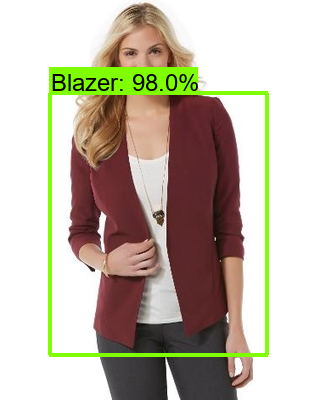

In [10]:
d = result_data.iloc[828]
test_image_o = cv2.imread('../'+d[0])
test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
image_with_detections = test_image_rgb.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            np.array([d[['xmin','ymin','xmax','ymax']].values]),
            [d['class']],
            [d['score']],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
Image.fromarray(image_with_detections)

In [11]:
cat_index = dict()
for i,d in category_index.items():
    cat_index[d['id']] = d['name']
cat_index[0]='NA'
cat_index

{1: 'Blazer',
 2: 'Blouse',
 3: 'Cardigan',
 4: 'Dress',
 5: 'Jacket',
 6: 'Jeans',
 7: 'Romper',
 8: 'Shorts',
 9: 'Skirt',
 10: 'Sweater',
 11: 'Tank',
 12: 'Tee',
 13: 'Top',
 0: 'NA'}

In [14]:
result_data = result_data.merge(df[['filename','width','height']],on='filename',how='left')
result_data['x1'] = result_data['xmin']*result_data['width']
result_data['x2'] = result_data['xmax']*result_data['width']
result_data['y1'] = result_data['ymin']*result_data['height']
result_data['y2'] = result_data['ymax']*result_data['height']
result_data[['x1','x2','y1','y2']] = result_data[['x1','x2','y1','y2']].astype(int)
result_data['classname'] = result_data['class'].map(cat_index)
result_data

,filename,xmin,ymin,xmax,ymax,score,class,width,height,x1,x2,y1,y2,classname
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.267950,0.238123,0.868968,0.787527,0.941986,5,1460,1460,391,1268,347,1149,Jacket
1,img/Button-Front_Blazer/img_00000093.jpg,0.249332,0.235665,0.854626,0.761545,0.931356,1,1460,1460,364,1247,344,1111,Blazer
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.279500,0.283421,0.906245,0.760554,0.812228,5,1460,1460,408,1323,413,1110,Jacket
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.287530,0.230302,0.810815,0.774435,0.859211,5,1460,1460,419,1183,336,1130,Jacket
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.151922,0.379916,0.501294,0.651809,0.846900,1,1438,1438,218,720,546,937,Blazer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15595,img/Always_Be_Chic_Top/img_00000060.jpg,0.164816,0.030998,0.965523,0.971826,0.605451,10,400,300,65,386,9,291,Sweater
15596,img/Angel-Sleeved_Top/img_00000071.jpg,0.240997,0.075734,0.658261,0.921838,0.665758,10,300,400,72,197,30,368,Sweater
15597,img/Abstract_Buttoned_Top/img_00000029.jpg,0.023583,0.002219,0.998132,0.999870,0.679284,5,300,400,7,299,0,399,Jacket
15598,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.229892,0.253574,0.810779,0.706193,0.897720,11,300,400,68,243,101,282,Tank


In [23]:
main_directory = "../annotations/ensemble_outputs/28-2-22_ensemble_012_single/"
os.mkdir(main_directory)
with open(main_directory+'28-2-22_ensemble_012_single.pickle','wb') as f:
    pickle.dump(result_data,f)
    f.close()
with open(main_directory+'28-2-22_ensemble_012_single.pickle','rb') as f:
    result_data = pickle.load(f)
    f.close()
result_data

##### creating text files for the evaluation

In [25]:
base_directory = main_directory+"detections/"
if not os.path.exists(base_directory):
    os.makedirs(base_directory)
for i,d in tqdm(result_data.iterrows()):
    text_path = str(df[df.filename==d.filename].index[0])+'.txt'
    with open(base_directory+text_path, "a") as text_file:
        data_line = str(d['classname'])+" "+str(round(d['score'],5))+" "+str(d['x1'])+" "+str(d['y1'])+" "+str(d['x2'])+" "+str(d['y2'])
        text_file.write(data_line)

15600it [00:23, 656.85it/s]


In [26]:
base_directory = main_directory+"groundtruths/"
if not os.path.exists(base_directory):
    os.makedirs(base_directory)
for i,d in tqdm(df.iterrows()):
    text_path = str(i)+'.txt'
    with open(base_directory+text_path, "a") as text_file:
        data_line = str(d['class'])+" "+str(d['xmin'])+" "+str(d['ymin'])+" "+str(d['xmax'])+" "+str(d['ymax'])
        text_file.write(data_line)

15600it [00:05, 2780.95it/s]


#### creating text files for the muilt evaluation with single model

In [54]:
df = pd.read_csv('../annotations/csvs/uncropped_res_capped_balanced/test.csv')
# PATH_TO_LABELS = "../annotations/label_map.pbtxt"
# category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

# MODEL_LIST = ['faster_rcnn_resnet101_v1_640x640_BBOX.pkl','ssd_resnet152_v1_fpn_640x640.pkl','centernet_resnet101_v1_512x512_BBOX.pkl']
# predictions_dict = {}
# for i in range(len(MODEL_LIST)):
#     with open('../annotations/ensemble_outputs/'+MODEL_LIST[i], 'rb') as f:
#         predictions_dict[i] = pickle.load(f)
        
PATH_TO_LABELS = "../annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)

MODEL_LIST = os.listdir('../annotations/ensemble_outputs/single_model_preds')
predictions_dict = {}
for i in range(len(MODEL_LIST)):
    with open('../annotations/ensemble_outputs/single_model_preds/'+MODEL_LIST[i], 'rb') as f:
        predictions_dict[i] = pickle.load(f)
MODEL_LIST

['centernet_resnet101_v1_512x512_BBOX.pkl',
 'faster_rcnn_inception_resnet_v2_640x640_BBOX.pkl',
 'faster_rcnn_resnet101_v1_1024x1024_BBOX.pkl',
 'faster_rcnn_resnet101_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_640x640_BBOX.pkl',
 'faster_rcnn_resnet152_v1_800x1333_BBOX.pkl',
 'faster_rcnn_resnet50_v1_640x640_BBOX.pkl',
 'ssd_resnet152_v1_fpn_640x640.pkl']

In [29]:
with open('../annotations/ensemble_outputs/single_model_preds/'+MODEL_LIST[1],'rb') as f:
    result_data = pickle.load(f)
    f.close()
result_data

[{'detection_anchor_indices': array([76186., 76013., 74963., 76177., 76106., 76093., 76359., 76006.,
         76276., 76276., 76177., 76177., 76359., 76361., 76569., 74231.,
         76278., 76278., 76352., 76352., 74780., 74774., 76569., 75156.,
         75139., 75138., 76569., 75119., 76278., 76260., 75119., 76454.,
         75174., 73355., 76453., 75182., 76469., 74231., 70352., 76362.,
         75191., 76698., 76469., 75191., 76698., 75129., 74231., 76454.,
         75130., 76278., 75833., 74285., 75315., 74411., 74822., 76704.,
         76665., 76368., 70343., 74411., 76432., 75119., 76353., 73716.,
         70532., 76593., 76380., 73355., 75165., 75342., 76443., 76368.,
         74822., 70424., 75833., 67454., 75146., 74231., 74627., 76278.,
         76367., 76278., 74822., 76432., 76373., 74767., 75518., 75121.,
         75183., 76278., 73353., 74949., 76698., 76638., 76470., 76368.,
         74231., 73690., 74955., 74796.], dtype=float32),
  'detection_boxes': array([[0.2592553

In [31]:
def calculations2(combine,n_model):
    results = list()
    for i in tqdm(range(df.shape[0])):
    # for i in tqdm(range(100)):
        fname,bboxes,scores,classes = combine.single_model(location=i,model=n_model)
        if scores:
            for j in range(len(scores)):
                results.append([fname,*bboxes[j],scores[j],classes[j],1])
        else:
            results.append([fname,*[0]*6,0])
    return pd.pandas.DataFrame(results,columns=['filename','xmin','ymin','xmax','ymax','score','class','status'])

In [30]:
# MODEL_LIST[1],MODEL_LIST[2],MODEL_LIST[4],MODEL_LIST[5],
MODEL_LIST[1]

'efficientdet_d1_BBOX.pkl'

In [32]:
imp.reload(OD_Assemble)
# def __init__(self,indexes=[0,1,2],con_thresh=0.6,iou_thresh=0.55): defalut
combine = OD_Assemble.NCombiner(con_thresh=0.5)
result_data = calculations2(combine,1)
result_data

100%|██████████| 15600/15600 [00:02<00:00, 6015.72it/s]


,filename,xmin,ymin,xmax,ymax,score,class,status
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.259255,0.258893,0.878386,0.765484,0.509324,5,1
1,img/Button-Front_Blazer/img_00000093.jpg,0.263788,0.234891,0.845681,0.757142,0.694944,1,1
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.275892,0.297440,0.905153,0.747500,0.501957,1,1
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.155277,0.378484,0.503655,0.634836,0.561231,1,1
...,...,...,...,...,...,...,...,...
15623,img/Always_Be_Chic_Top/img_00000060.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0
15624,img/Angel-Sleeved_Top/img_00000071.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0
15625,img/Abstract_Buttoned_Top/img_00000029.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0
15626,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0


In [67]:
result_data.status.value_counts()

1    23109
0      568
Name: status, dtype: int64

In [33]:
result_data.status.value_counts()

1    8912
0    6716
Name: status, dtype: int64

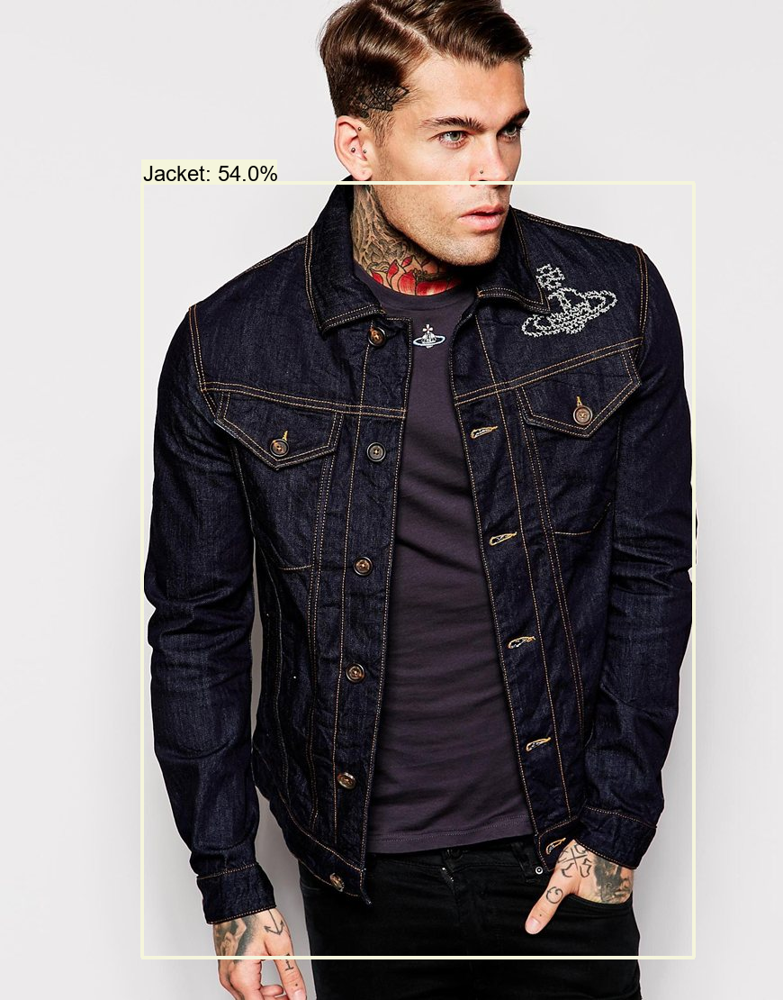

In [35]:
d = result_data.iloc[110]
test_image_o = cv2.imread('../'+d[0])
test_image_rgb = cv2.cvtColor(test_image_o, cv2.COLOR_BGR2RGB)
image_with_detections = test_image_rgb.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
            image_with_detections,
            np.array([d[['xmin','ymin','xmax','ymax']].values]),
            [d['class']],
            [d['score']],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=0.5,
            agnostic_mode=False)
Image.fromarray(image_with_detections)

In [36]:
cat_index = dict()
for i,d in category_index.items():
    cat_index[d['id']] = d['name']
cat_index[0]='NA'
cat_index

{1: 'Blazer',
 2: 'Blouse',
 3: 'Cardigan',
 4: 'Dress',
 5: 'Jacket',
 6: 'Jeans',
 7: 'Romper',
 8: 'Shorts',
 9: 'Skirt',
 10: 'Sweater',
 11: 'Tank',
 12: 'Tee',
 13: 'Top',
 0: 'NA'}

In [37]:
result_data = result_data.merge(df[['filename','width','height']],on='filename',how='left')
result_data['x1'] = result_data['xmin']*result_data['width']
result_data['x2'] = result_data['xmax']*result_data['width']
result_data['y1'] = result_data['ymin']*result_data['height']
result_data['y2'] = result_data['ymax']*result_data['height']
result_data[['x1','x2','y1','y2']] = result_data[['x1','x2','y1','y2']].astype(int)
result_data['classname'] = result_data['class'].map(cat_index)
result_data

,filename,xmin,ymin,xmax,ymax,score,class,status,width,height,x1,x2,y1,y2,classname
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.259255,0.258893,0.878386,0.765484,0.509324,5,1,1460,1460,378,1282,377,1117,Jacket
1,img/Button-Front_Blazer/img_00000093.jpg,0.263788,0.234891,0.845681,0.757142,0.694944,1,1,1460,1460,385,1234,342,1105,Blazer
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.275892,0.297440,0.905153,0.747500,0.501957,1,1,1460,1460,402,1321,434,1091,Blazer
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,1460,1460,0,0,0,0,NA
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.155277,0.378484,0.503655,0.634836,0.561231,1,1,1438,1438,223,724,544,912,Blazer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15623,img/Always_Be_Chic_Top/img_00000060.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,400,300,0,0,0,0,NA
15624,img/Angel-Sleeved_Top/img_00000071.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,300,400,0,0,0,0,NA
15625,img/Abstract_Buttoned_Top/img_00000029.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,300,400,0,0,0,0,NA
15626,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,300,400,0,0,0,0,NA


In [39]:
# main_directory = "../annotations/ensemble_outputs/efficientdet_d1/"
# os.mkdir(main_directory)
# with open(main_directory+'efficientdet_d1_DF.pickle','wb') as f:
#     pickle.dump(result_data,f)
#     f.close()
# with open(main_directory+'efficientdet_d1_DF.pickle','rb') as f:
#     result_data = pickle.load(f)    
#     f.close()
# result_data

,filename,xmin,ymin,xmax,ymax,score,class,status,width,height,x1,x2,y1,y2,classname
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,0.259255,0.258893,0.878386,0.765484,0.509324,5,1,1460,1460,378,1282,377,1117,Jacket
1,img/Button-Front_Blazer/img_00000093.jpg,0.263788,0.234891,0.845681,0.757142,0.694944,1,1,1460,1460,385,1234,342,1105,Blazer
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,0.275892,0.297440,0.905153,0.747500,0.501957,1,1,1460,1460,402,1321,434,1091,Blazer
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,1460,1460,0,0,0,0,NA
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,0.155277,0.378484,0.503655,0.634836,0.561231,1,1,1438,1438,223,724,544,912,Blazer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15623,img/Always_Be_Chic_Top/img_00000060.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,400,300,0,0,0,0,NA
15624,img/Angel-Sleeved_Top/img_00000071.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,300,400,0,0,0,0,NA
15625,img/Abstract_Buttoned_Top/img_00000029.jpg,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,300,400,0,0,0,0,NA
15626,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,300,400,0,0,0,0,NA


In [ ]:
main_directory = "../annotations/ensemble_outputs/faster_rcnn_resnet50_v1_640x640_Single/"
os.mkdir(main_directory)
with open(main_directory+'faster_rcnn_resnet50_v1_640x640_DF.pickle','wb') as f:
    pickle.dump(result_data,f)
    f.close()
with open(main_directory+'faster_rcnn_resnet50_v1_640x640_DF.pickle','rb') as f:
    result_data = pickle.load(f)    
    f.close()
result_data

In [40]:
base_directory = main_directory+"detections/"
if not os.path.exists(base_directory):
    os.makedirs(base_directory)
for i,d in tqdm(result_data.iterrows()):
    text_path = str(df[df.filename==d.filename].index[0])+'.txt'
    with open(base_directory+text_path, "a+") as text_file:
        # check status
        if d.status==1:
            data_line = str(d['classname'])+" "+str(round(d['score'],5))+" "+str(d['x1'])+" "+str(d['y1'])+" "+str(d['x2'])+" "+str(d['y2'])
            text_file.seek(0)
            exist_data = text_file.read(100)
            if len(exist_data) > 0 :
                text_file.write("\n")
            text_file.write(data_line)

15628it [00:32, 478.81it/s]
